<a href="https://colab.research.google.com/github/kazarezova/bioinformatics_for_NGS_scRNAseq/blob/main/kazarezova_ngs_scRNAseq.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1.1 
Найдите датасет scRNA-Seq, соответствующий вашим
научным интересам. Важно, чтобы у этого датасета уже была готовая
аннотация. Создайте AnnData-объект с этим датасетом (лучше, чтобы это был
датасет, состоящий всего из одного батча). В колонке
adata.obs["cell_type"] должна содержаться аннотация клеток по типам.

In [ ]:
# Установка необходимых библиотек
!pip3 install scanpy scrublet scikit-misc leidenalg

# Необходимо, чтобы конкретно прогрузился matplotlib
import os
os.kill(os.getpid(), 9)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.0 MB 37.2 MB/s 
     |████████████████████████████████| 8.8 MB 51.0 MB/s 
     |████████████████████████████████| 1.3 MB 51.5 MB/s 
     |████████████████████████████████| 9.4 MB 68.6 MB/s 
     |████████████████████████████████| 88 kB 7.8 MB/s 
     |████████████████████████████████| 96 kB 5.9 MB/s 
     |████████████████████████████████| 295 kB 60.7 MB/s 
     |████████████████████████████████| 965 kB 68.8 MB/s 
     |████████████████████████████████| 1.1 MB 65.6 MB/s 
     |████████████████████████████████| 647 kB 75.8 MB/s 
     |████████████████████████████████| 3.3 MB 56.2 MB/s 
     |████████████████████████████████| 63 kB 2.8 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=29d63d26efab2467348bf49f062a171010685d6e59d03356b723813e7e0f77b1
  Stored in directory: /root/.cache/pip/wheels/a9/3a/

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import scanpy.external as sce
import sys

In [2]:
warnings.filterwarnings("ignore") # Отключаем warning'и, которые могут мешать по ходу работы
sc.settings.verbosity = 3 # Делаем так, чтобы scanpy выводил максимально подробные логи

# Настраиваем общую эстетику картинок
sc.settings.set_figure_params(dpi=150) # Качество картинок
sns.set(font_scale=1) # Размер шрифта
sns.set_style("ticks") # Стиль картинок

In [3]:
adata = sc.read_h5ad("motor_cortex.h5ad")
adata.var_names_make_unique()
print(adata) # Выведем содержимое

AnnData object with n_obs × n_vars = 10739 × 14412
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'BICCN_cluster_label', 'cluster_id', 'cluster_color', 'BICCN_subclass_label', 'subclass_id', 'sample_id', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.3', 'seurat_clusters', 'seurat_clusters.new', 'label_for_heatmap', 'BICCN_ontology_term_id', 'assay_ontology_term_id', 'disease_ontology_term_id', 'tissue_ontology_term_id', 'cell_type_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'development_stage_ontology_term_id', 'organism_ontology_term_id', 'sex_ontology_term_id', 'is_primary_data', 'suspension_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage'
    var: 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype'
    uns: 'BICCN_subclass_label_colors', 'schema_version', 'title'
    obsm: 'X_pca', 'X_tsne'


In [4]:
adata.X

<10739x14412 sparse matrix of type '<class 'numpy.float32'>'
	with 19922710 stored elements in Compressed Sparse Row format>

In [5]:
adata.obs # Шапка датафрейма с аннотацией клеток

,nCount_RNA,nFeature_RNA,donor_id,BICCN_cluster_label,cluster_id,cluster_color,BICCN_subclass_label,subclass_id,sample_id,nCount_SCT,...,is_primary_data,suspension_type,cell_type,assay,disease,organism,sex,tissue,self_reported_ethnicity,development_stage
human_AAAGGTATCGGCTGGT-21L8TX_180927_001_A01,5026.0,2228,H18.30.001,Oligo L3-6 OPALIN ENPP6,119,#1a3329,Oligo,17,AAAGGTATCGGCTGGT-21L8TX_180927_001_A01,4132.0,...,True,nucleus,oligodendrocyte,10x 3' v3,normal,Homo sapiens,female,primary motor cortex,unknown,60-year-old human stage
human_AAGAACACAACACGAG-21L8TX_180927_001_A01,5798.0,2767,H18.30.001,Oligo L2-6 OPALIN MAP6D1,79,#387567,Oligo,17,AAGAACACAACACGAG-21L8TX_180927_001_A01,4305.0,...,True,nucleus,oligodendrocyte,10x 3' v3,normal,Homo sapiens,female,primary motor cortex,unknown,60-year-old human stage
human_AAGCGTTCAAGGAGTC-21L8TX_180927_001_A01,1778.0,1241,H18.30.001,Micro L1-6 TYROBP CD74,128,#94AF97,Micro-PVM,20,AAGCGTTCAAGGAGTC-21L8TX_180927_001_A01,2728.0,...,True,nucleus,microglial cell,10x 3' v3,normal,Homo sapiens,female,primary motor cortex,unknown,60-year-old human stage
human_AATGGAAAGTCGAGGT-21L8TX_180927_001_A01,4272.0,1990,H18.30.001,Oligo L2-6 OPALIN FTH1P3,120,#003a28,Oligo,17,AATGGAAAGTCGAGGT-21L8TX_180927_001_A01,3939.0,...,True,nucleus,oligodendrocyte,10x 3' v3,normal,Homo sapiens,female,primary motor cortex,unknown,60-year-old human stage
human_AATTCCTGTCATCACA-21L8TX_180927_001_A01,3776.0,1720,H18.30.001,Oligo L2-6 OPALIN FTH1P3,120,#003a28,Oligo,17,AATTCCTGTCATCACA-21L8TX_180927_001_A01,3716.0,...,True,nucleus,oligodendrocyte,10x 3' v3,normal,Homo sapiens,female,primary motor cortex,unknown,60-year-old human stage
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
mouse_pBICCNsMMrMOpRPiM008d190320_TTGAACGTCGTTGTGA,5325.0,2513,M008,Oligo Enpp6_1,95,#374A45,Oligo,18,pBICCNsMMrMOpRPiM008d190320_TTGAACGTCGTTGTGA,4341.0,...,True,nucleus,oligodendrocyte,10x 3' v3,normal,Mus musculus,male,primary motor cortex,na,early adult stage
mouse_pBICCNsMMrMOpRPiM008d190320_TTGGTTTTCGCATTAG,4260.0,2349,M008,Astro Aqp4_Gfap,93,#5A503F,Astro,17,pBICCNsMMrMOpRPiM008d190320_TTGGTTTTCGCATTAG,4087.0,...,True,nucleus,astrocyte,10x 3' v3,normal,Mus musculus,male,primary motor cortex,na,early adult stage
mouse_pBICCNsMMrMOpRPiM008d190320_TTTCACATCTGAGCAT,1169.0,898,M008,PVM_1,114,#8BA38D,Micro-PVM,23,pBICCNsMMrMOpRPiM008d190320_TTTCACATCTGAGCAT,2594.0,...,True,nucleus,microglial cell,10x 3' v3,normal,Mus musculus,male,primary motor cortex,na,early adult stage
mouse_pBICCNsMMrMOpRPiM008d190320_TTTGATCCAGGCTACC,1217.0,935,M008,Peri,112,#A77C70,Peri,22,pBICCNsMMrMOpRPiM008d190320_TTTGATCCAGGCTACC,2641.0,...,True,nucleus,pericyte,10x 3' v3,normal,Mus musculus,male,primary motor cortex,na,early adult stage


In [6]:
adata.obs['cell_type'] # Столбец cell_type

human_AAAGGTATCGGCTGGT-21L8TX_180927_001_A01          oligodendrocyte
human_AAGAACACAACACGAG-21L8TX_180927_001_A01          oligodendrocyte
human_AAGCGTTCAAGGAGTC-21L8TX_180927_001_A01          microglial cell
human_AATGGAAAGTCGAGGT-21L8TX_180927_001_A01          oligodendrocyte
human_AATTCCTGTCATCACA-21L8TX_180927_001_A01          oligodendrocyte
                                                           ...       
mouse_pBICCNsMMrMOpRPiM008d190320_TTGAACGTCGTTGTGA    oligodendrocyte
mouse_pBICCNsMMrMOpRPiM008d190320_TTGGTTTTCGCATTAG          astrocyte
mouse_pBICCNsMMrMOpRPiM008d190320_TTTCACATCTGAGCAT    microglial cell
mouse_pBICCNsMMrMOpRPiM008d190320_TTTGATCCAGGCTACC           pericyte
mouse_pBICCNsMMrMOpRPiM008d190320_TTTGATCGTTGTGCAT          astrocyte
Name: cell_type, Length: 10739, dtype: category
Categories (8, object): ['endothelial cell', 'astrocyte', 'oligodendrocyte', 'microglial cell',
                         'smooth muscle cell', 'pericyte', 'leptomeningeal cell',
    

In [7]:
adata.var.head() # Шапка датафрейма с аннотацией генов

,feature_is_filtered,feature_name,feature_reference,feature_biotype
feature_id,,,,
ENSG00000140463,False,BBS4,NCBITaxon:9606,gene
ENSG00000125533,False,BHLHE23,NCBITaxon:9606,gene
ENSG00000182667,False,NTM,NCBITaxon:9606,gene
ENSG00000101440,False,ASIP,NCBITaxon:9606,gene
ENSG00000100568,False,VTI1B,NCBITaxon:9606,gene


In [8]:
adata.var['feature_id'] = adata.var_names
adata.var.set_index('feature_name', inplace=True)
adata.var.head()

,feature_is_filtered,feature_reference,feature_biotype,feature_id
feature_name,,,,
BBS4,False,NCBITaxon:9606,gene,ENSG00000140463
BHLHE23,False,NCBITaxon:9606,gene,ENSG00000125533
NTM,False,NCBITaxon:9606,gene,ENSG00000182667
ASIP,False,NCBITaxon:9606,gene,ENSG00000101440
VTI1B,False,NCBITaxon:9606,gene,ENSG00000100568


# 1.2 
Проведите контроль качества этого датасета способами,
которые были обговорены во время семинаров. Обязательно покажите все
необходимые диагностические графики.


In [9]:
# Выделяем митохондриальные гены
adata.var["mt"] = adata.var_names.str.startswith("MT-") # В датафрейме с описанием генов делаем отдельный столбик, в котором будет храниться True, если ген митохондриальный
adata.var.head()

,feature_is_filtered,feature_reference,feature_biotype,feature_id,mt
feature_name,,,,,
BBS4,False,NCBITaxon:9606,gene,ENSG00000140463,False
BHLHE23,False,NCBITaxon:9606,gene,ENSG00000125533,False
NTM,False,NCBITaxon:9606,gene,ENSG00000182667,False
ASIP,False,NCBITaxon:9606,gene,ENSG00000101440,False
VTI1B,False,NCBITaxon:9606,gene,ENSG00000100568,False


In [10]:
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True) # Подсчитываем QC
adata.obs.head()

,nCount_RNA,nFeature_RNA,donor_id,BICCN_cluster_label,cluster_id,cluster_color,BICCN_subclass_label,subclass_id,sample_id,nCount_SCT,...,disease,organism,sex,tissue,self_reported_ethnicity,development_stage,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
human_AAAGGTATCGGCTGGT-21L8TX_180927_001_A01,5026.0,2228,H18.30.001,Oligo L3-6 OPALIN ENPP6,119,#1a3329,Oligo,17,AAAGGTATCGGCTGGT-21L8TX_180927_001_A01,4132.0,...,normal,Homo sapiens,female,primary motor cortex,unknown,60-year-old human stage,2227,2029.401245,0.0,0.0
human_AAGAACACAACACGAG-21L8TX_180927_001_A01,5798.0,2767,H18.30.001,Oligo L2-6 OPALIN MAP6D1,79,#387567,Oligo,17,AAGAACACAACACGAG-21L8TX_180927_001_A01,4305.0,...,normal,Homo sapiens,female,primary motor cortex,unknown,60-year-old human stage,2737,2327.366699,0.0,0.0
human_AAGCGTTCAAGGAGTC-21L8TX_180927_001_A01,1778.0,1241,H18.30.001,Micro L1-6 TYROBP CD74,128,#94AF97,Micro-PVM,20,AAGCGTTCAAGGAGTC-21L8TX_180927_001_A01,2728.0,...,normal,Homo sapiens,female,primary motor cortex,unknown,60-year-old human stage,1255,1330.697754,0.0,0.0
human_AATGGAAAGTCGAGGT-21L8TX_180927_001_A01,4272.0,1990,H18.30.001,Oligo L2-6 OPALIN FTH1P3,120,#003a28,Oligo,17,AATGGAAAGTCGAGGT-21L8TX_180927_001_A01,3939.0,...,normal,Homo sapiens,female,primary motor cortex,unknown,60-year-old human stage,1989,1897.819580,0.0,0.0
human_AATTCCTGTCATCACA-21L8TX_180927_001_A01,3776.0,1720,H18.30.001,Oligo L2-6 OPALIN FTH1P3,120,#003a28,Oligo,17,AATTCCTGTCATCACA-21L8TX_180927_001_A01,3716.0,...,normal,Homo sapiens,female,primary motor cortex,unknown,60-year-old human stage,1720,1681.663696,0.0,0.0


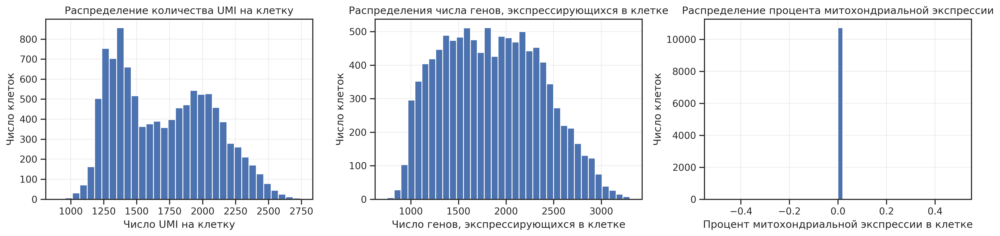

In [11]:
fig, axes = plt.subplots(ncols=3, nrows=1, figsize=(16, 4)) # Создаём сетку, чтобы отрисовать три графика

# Отрисовываем распределение общего числа UMI
sns.distplot(adata.obs["total_counts"], kde=False, ax=axes[0], hist_kws={"alpha":1})
axes[0].set_xlabel("Число UMI на клетку")
axes[0].set_ylabel("Число клеток")
axes[0].set_title("Распределение количества UMI на клетку")
axes[0].grid(alpha=0.3)

# Отрисовываем распределение числа генов по клеткам
sns.distplot(adata.obs["n_genes_by_counts"], kde=False, ax=axes[1], hist_kws={"alpha":1})
axes[1].set_xlabel("Число генов, экспрессирующихся в клетке")
axes[1].set_ylabel("Число клеток")
axes[1].set_title("Распределения числа генов, экспрессирующихся в клетке")
axes[1].grid(alpha=0.3)

# Отрисовываем распределение митохондриальной экспрессии
sns.distplot(adata.obs["pct_counts_mt"], kde=False, ax=axes[2], hist_kws={"alpha":1})
axes[2].set_xlabel("Процент митохондриальной экспрессии в клетке")
axes[2].set_ylabel("Число клеток")
axes[2].set_title("Распределение процента митохондриальной экспрессии")
axes[2].grid(alpha=0.3)

fig.tight_layout()

# 1.3 
Проанализируйте датасет стандартным пайплайном
log1pPF, который мы рассматривали во время семинара. Нарисуйте итоговый
эмбеддинг при помощи UMAP и отразите на нём цветом (а) итоговые кластера
и (б) изначальные типы клеток. Сходится ли на первый взгляд кластеризация?

In [12]:
adata_before_log1p = adata # Сохраним текущую версию adata, чтобы в пункте 1.4 было с чем сравнить

### Устранение дуплетов

In [13]:
sce.pp.scrublet(adata) # Запускаем scrublet для обнаружения дублетов

Running Scrublet
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
    Scrublet finished (0:00:21)


In [14]:
adata.obs.head() # Посмотрим начало датафрейма adata.obs

,nCount_RNA,nFeature_RNA,donor_id,BICCN_cluster_label,cluster_id,cluster_color,BICCN_subclass_label,subclass_id,sample_id,nCount_SCT,...,sex,tissue,self_reported_ethnicity,development_stage,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,doublet_score,predicted_doublet
human_AAAGGTATCGGCTGGT-21L8TX_180927_001_A01,5026.0,2228,H18.30.001,Oligo L3-6 OPALIN ENPP6,119,#1a3329,Oligo,17,AAAGGTATCGGCTGGT-21L8TX_180927_001_A01,4132.0,...,female,primary motor cortex,unknown,60-year-old human stage,2227,2029.401245,0.0,0.0,0.007433,False
human_AAGAACACAACACGAG-21L8TX_180927_001_A01,5798.0,2767,H18.30.001,Oligo L2-6 OPALIN MAP6D1,79,#387567,Oligo,17,AAGAACACAACACGAG-21L8TX_180927_001_A01,4305.0,...,female,primary motor cortex,unknown,60-year-old human stage,2737,2327.366699,0.0,0.0,0.104793,False
human_AAGCGTTCAAGGAGTC-21L8TX_180927_001_A01,1778.0,1241,H18.30.001,Micro L1-6 TYROBP CD74,128,#94AF97,Micro-PVM,20,AAGCGTTCAAGGAGTC-21L8TX_180927_001_A01,2728.0,...,female,primary motor cortex,unknown,60-year-old human stage,1255,1330.697754,0.0,0.0,0.019007,False
human_AATGGAAAGTCGAGGT-21L8TX_180927_001_A01,4272.0,1990,H18.30.001,Oligo L2-6 OPALIN FTH1P3,120,#003a28,Oligo,17,AATGGAAAGTCGAGGT-21L8TX_180927_001_A01,3939.0,...,female,primary motor cortex,unknown,60-year-old human stage,1989,1897.819580,0.0,0.0,0.011692,False
human_AATTCCTGTCATCACA-21L8TX_180927_001_A01,3776.0,1720,H18.30.001,Oligo L2-6 OPALIN FTH1P3,120,#003a28,Oligo,17,AATTCCTGTCATCACA-21L8TX_180927_001_A01,3716.0,...,female,primary motor cortex,unknown,60-year-old human stage,1720,1681.663696,0.0,0.0,0.004463,False


In [15]:
adata = adata[~adata.obs.predicted_doublet]
print(adata)

View of AnnData object with n_obs × n_vars = 10731 × 14412
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'BICCN_cluster_label', 'cluster_id', 'cluster_color', 'BICCN_subclass_label', 'subclass_id', 'sample_id', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.3', 'seurat_clusters', 'seurat_clusters.new', 'label_for_heatmap', 'BICCN_ontology_term_id', 'assay_ontology_term_id', 'disease_ontology_term_id', 'tissue_ontology_term_id', 'cell_type_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'development_stage_ontology_term_id', 'organism_ontology_term_id', 'sex_ontology_term_id', 'is_primary_data', 'suspension_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'predicted_doublet'
    var: 'feature_is_filtered', 'feature_reference', 'feature_biotype', 'feature_id', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_drop

### Контроль за дисперсией

In [16]:
adata.layers["counts"] = adata.X.copy() # Сохраняем в слой counts значения сырых каунтов

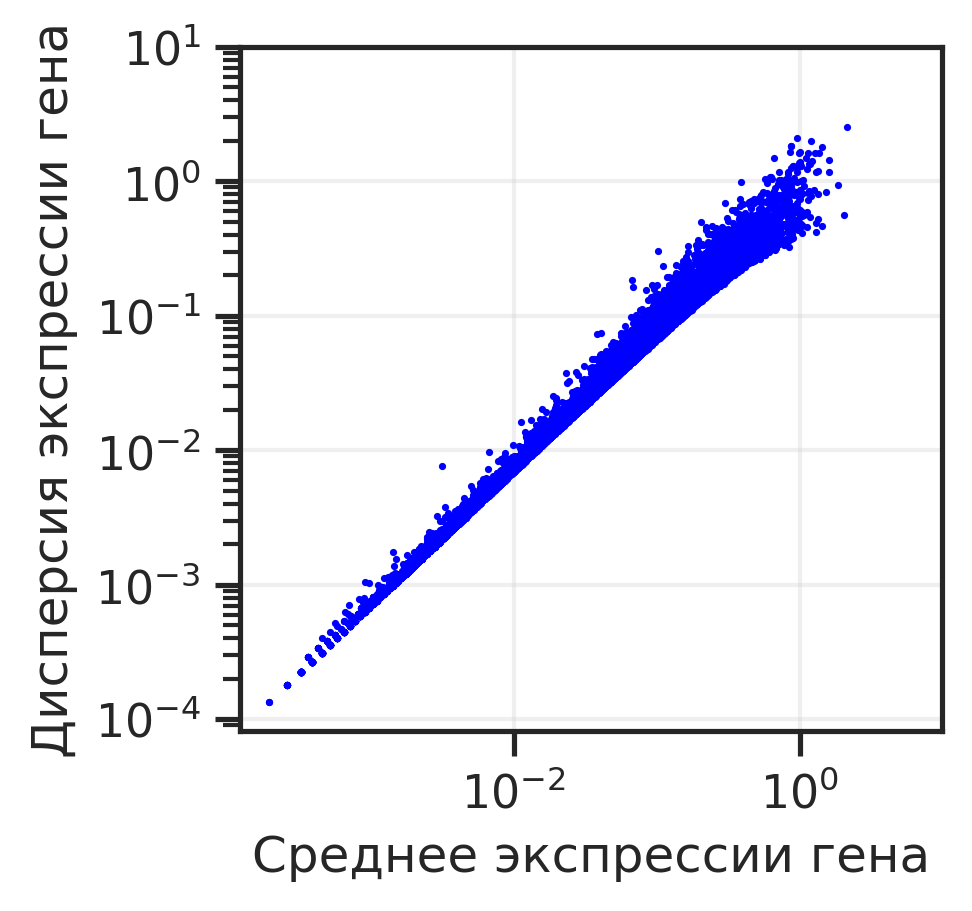

In [17]:
variance = np.var(adata.layers["counts"].A, axis=0)
mean = np.mean(adata.layers["counts"].A, axis=0)

mean = mean[variance > 0]
variance = variance[variance > 0]

fig, ax = plt.subplots(dpi=150, figsize=(3, 3))

sns.scatterplot(x=mean, y=variance, linewidth=0, s=3, color="blue", ax=ax)
ax.set_xlabel("Среднее экспрессии гена"); ax.set_ylabel("Дисперсия экспрессии гена")
ax.set_xscale("log"); ax.set_yscale("log")
ax.set_xlim(0, 10); ax.set_ylim(0, 10)

ax.grid(alpha=0.3)

In [18]:
print("Суммы UMI на клетку до нормировки:", adata.X.sum(axis=1).T)

sc.pp.normalize_total(adata) # Нормировка
print("Суммы UMI на клетку после нормировки:", adata.X.sum(axis=1).T)

Суммы UMI на клетку до нормировки: [[2029.4012 2327.3667 1330.6978 ... 1180.4708 1206.758  1475.822 ]]
normalizing counts per cell
    finished (0:00:00)
Суммы UMI на клетку после нормировки: [[1680.3204 1680.3202 1680.3203 ... 1680.3204 1680.3206 1680.3201]]


In [19]:
sc.pp.log1p(adata) # Натуральный логарифм ln(x + 1)

### Подготовка к кластеризации и снижению размерности

In [20]:
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000,
    layer="counts",
    flavor="seurat_v3",
) # Выделяем высоко вариабельные гены (HVG)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


In [21]:
adata.var.head() # Выводим верхушку adata.var

,feature_is_filtered,feature_reference,feature_biotype,feature_id,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,highly_variable_rank,means,variances,variances_norm
feature_name,,,,,,,,,,,,,,
BBS4,False,NCBITaxon:9606,gene,ENSG00000140463,False,1312,0.090904,87.782848,976.234741,False,NaN,0.090907,0.061928,0.911818
BHLHE23,False,NCBITaxon:9606,gene,ENSG00000125533,False,8,0.000554,99.925505,5.950643,True,2584.0,0.000555,0.000426,1.082112
NTM,False,NCBITaxon:9606,gene,ENSG00000182667,False,6436,1.274098,40.068908,13682.800781,True,217.0,1.273926,1.627019,1.717221
ASIP,False,NCBITaxon:9606,gene,ENSG00000101440,False,1407,0.106604,86.898221,1144.834839,False,NaN,0.106619,0.082843,1.037112
VTI1B,False,NCBITaxon:9606,gene,ENSG00000100568,False,2479,0.185787,76.915914,1995.167847,False,NaN,0.185759,0.125486,0.892522


In [22]:
adata.raw = adata

In [23]:
adata = adata[:, adata.var.highly_variable] # Оставляем только подмножество генов, которые относятся к HVG
print(adata)

View of AnnData object with n_obs × n_vars = 10731 × 3000
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'BICCN_cluster_label', 'cluster_id', 'cluster_color', 'BICCN_subclass_label', 'subclass_id', 'sample_id', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.3', 'seurat_clusters', 'seurat_clusters.new', 'label_for_heatmap', 'BICCN_ontology_term_id', 'assay_ontology_term_id', 'disease_ontology_term_id', 'tissue_ontology_term_id', 'cell_type_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'development_stage_ontology_term_id', 'organism_ontology_term_id', 'sex_ontology_term_id', 'is_primary_data', 'suspension_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'predicted_doublet'
    var: 'feature_is_filtered', 'feature_reference', 'feature_biotype', 'feature_id', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropo

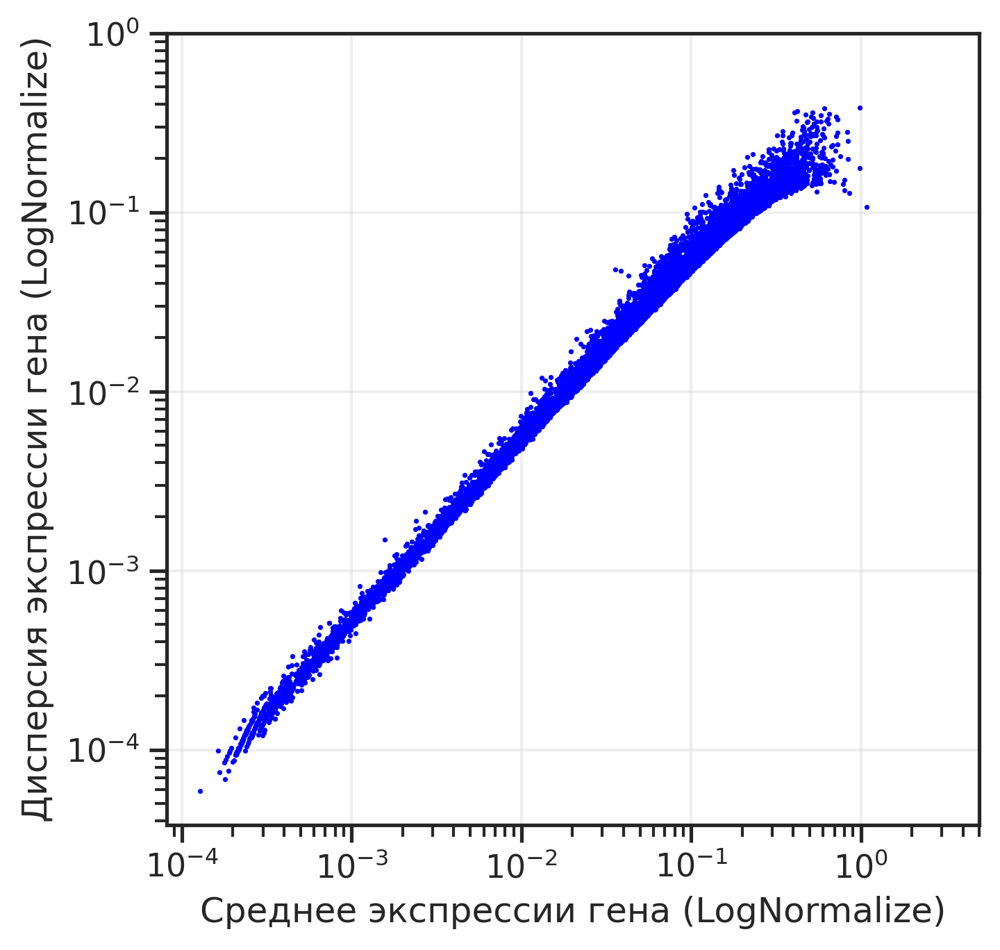

In [24]:
variance = np.var(adata.raw.X.A, axis=0)
mean = np.mean(adata.raw.X.A, axis=0)

mean = mean[variance > 0]
variance = variance[variance > 0]

fig, ax = plt.subplots(dpi=150, figsize=(5, 5))

sns.scatterplot(x=mean, y=variance, linewidth=0, s=3, color="blue", ax=ax)
ax.set_xlabel("Среднее экспрессии гена (LogNormalize)"); ax.set_ylabel("Дисперсия экспрессии гена (LogNormalize)")
ax.set_xscale("log")
ax.set_yscale("log")
ax.set_xlim(0, 5); ax.set_ylim(0, 1)

ax.grid(alpha=0.3)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


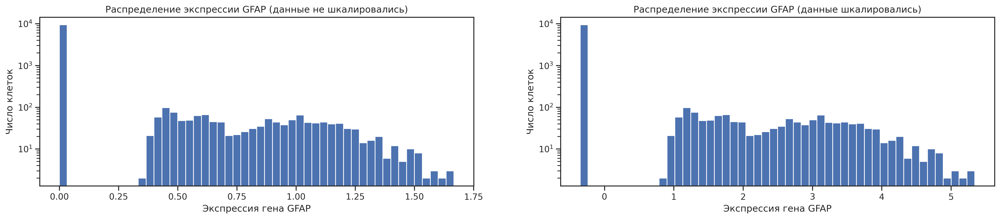

In [25]:
sc.pp.scale(adata) # Шкалирование

fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(22, 4)) # Создаём сетку, чтобы отрисовать два графика

# Отрисовываем распределение экспрессии гена GFAP на нешкалированных данных
sns.distplot(adata.raw[:, "GFAP"].X.todense(), kde=False, ax=axs[0], hist_kws={"alpha":1})
axs[0].set_xlabel("Экспрессия гена GFAP")
axs[0].set_ylabel("Число клеток")
axs[0].set_title("Распределение экспрессии GFAP (данные не шкалировались)")
axs[0].set_yscale("log")

# Отрисовываем распределение экспрессии гена GFAP на нешкалированных данных
sns.distplot(adata[:, "GFAP"].X, kde=False, ax=axs[1], hist_kws={"alpha":1})
axs[1].set_xlabel("Экспрессия гена GFAP")
axs[1].set_ylabel("Число клеток")
axs[1].set_title("Распределение экспрессии GFAP (данные шкалировались)")
axs[1].set_yscale("log")

### Снижение размерности и кластеризация

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)


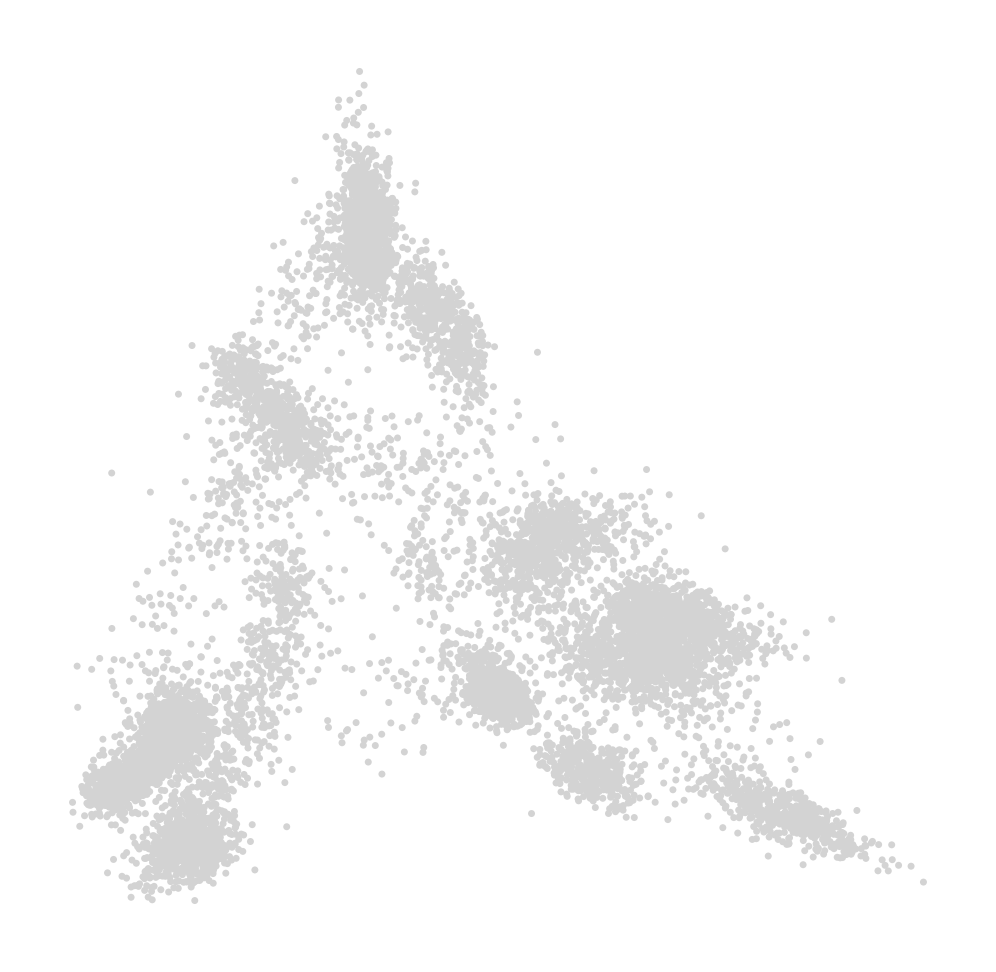

In [26]:
sc.tl.pca(adata) # Вычисляем PCA
sc.pl.pca(adata, frameon=False) # Отрисовываем PCA

SLC1A3 - экспрессионный маркер астроцитов, MBP - олигодендроцитов, PTPRC - микроглии

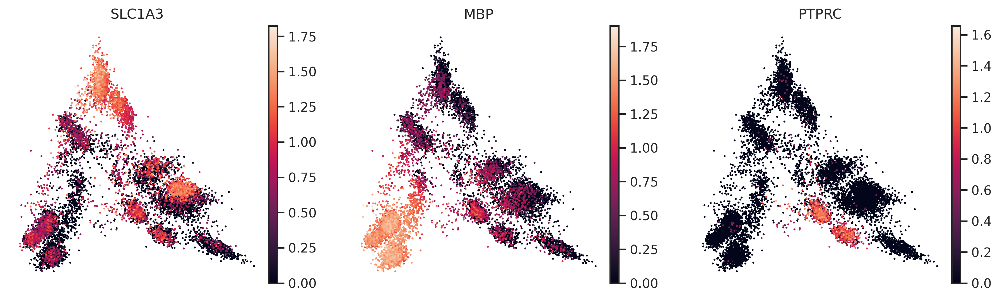

In [27]:
sc.pl.pca(adata, color=["SLC1A3", "MBP", "PTPRC"], frameon=False) # Отрисовываем PCA

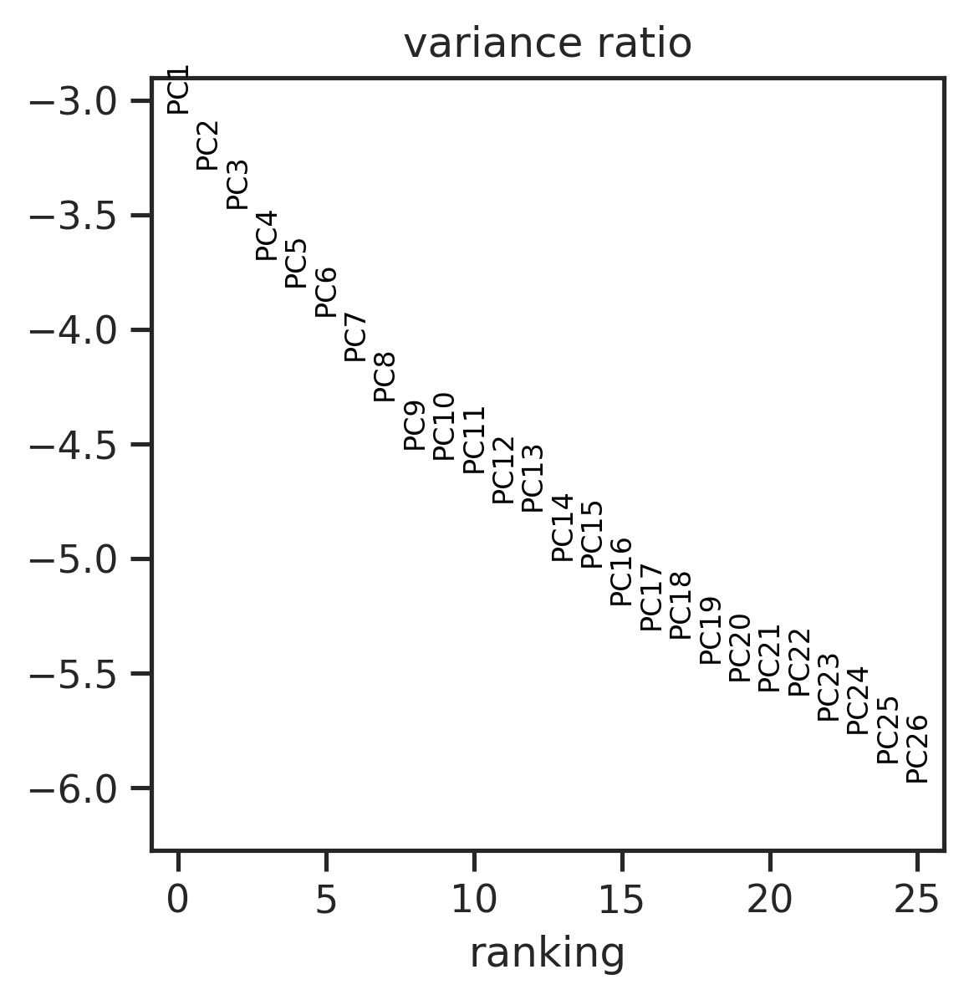

In [28]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=25)

In [29]:
sc.pp.neighbors(adata, n_pcs=15, n_neighbors=20) # Вычисление графа соседей - это необходимая стадия перед UMAP и t-SNE
sc.tl.umap(adata, min_dist=0.5) # Рассчёт UMAP
sc.tl.tsne(adata, n_pcs=15) # Рассчёт t-SNE

computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:38)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)
computing tSNE
    using 'X_pca' with n_pcs = 15
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:01:23)


<AxesSubplot: title={'center': 't-SNE'}, xlabel='tSNE1', ylabel='tSNE2'>

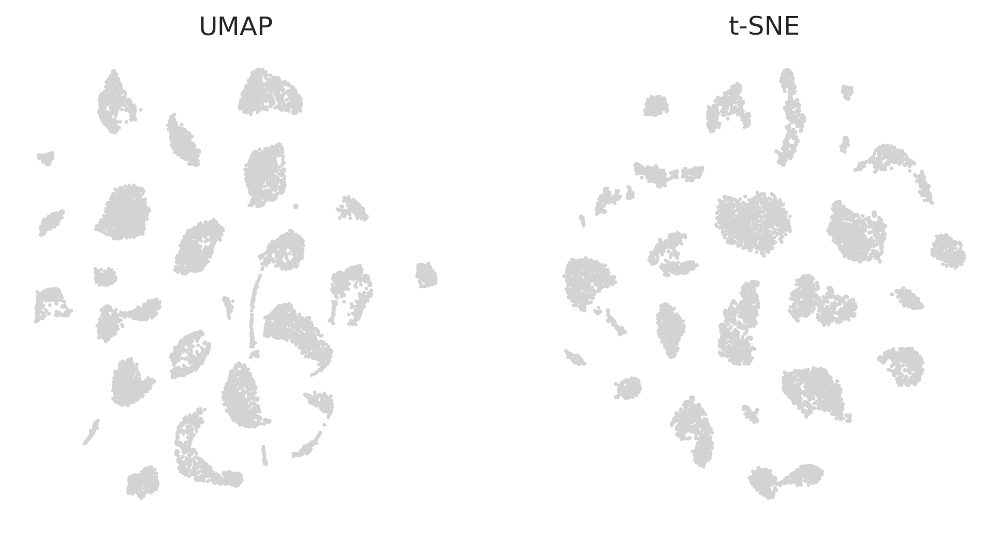

In [30]:
fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(8, 4))
sc.pl.umap(adata, frameon=False, ax=axs[0], title="UMAP", show=False) # Отрисовываем UMAP
sc.pl.tsne(adata, frameon=False, ax=axs[1], title="t-SNE", show=False) # Отрисовываем t-SNE

In [31]:
sc.tl.leiden(adata) # Кластеризация алгоритмом Leiden

running Leiden clustering
    finished: found 29 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


<AxesSubplot: title={'center': 't-SNE'}, xlabel='tSNE1', ylabel='tSNE2'>

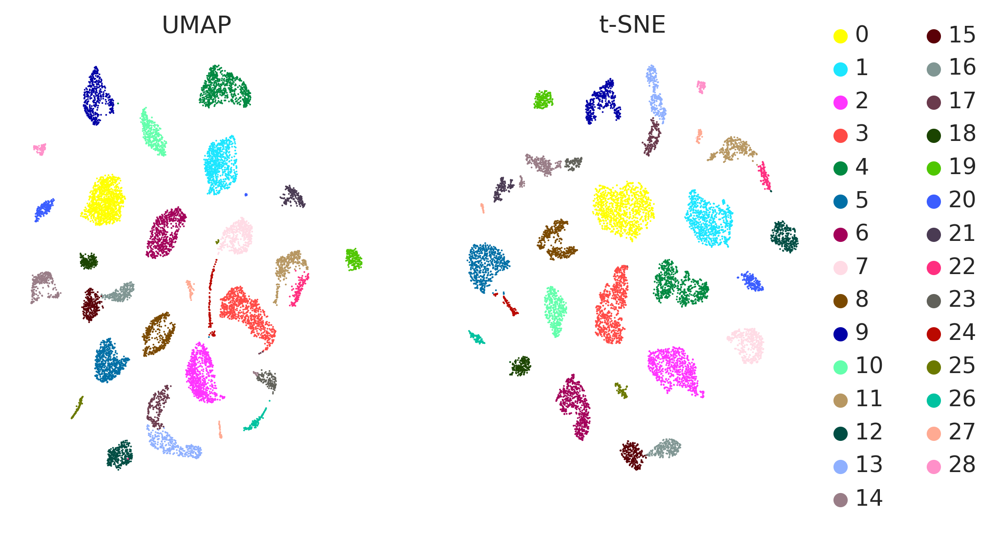

In [32]:
fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(7, 4))
sc.pl.umap(adata, color="leiden", frameon=False, ax=axs[0], title="UMAP", show=False, legend_loc=None, s=3) # Отрисовываем UMAP
sc.pl.tsne(adata, color="leiden", frameon=False, ax=axs[1], title="t-SNE", show=False, s=3) # Отрисовываем t-SNE

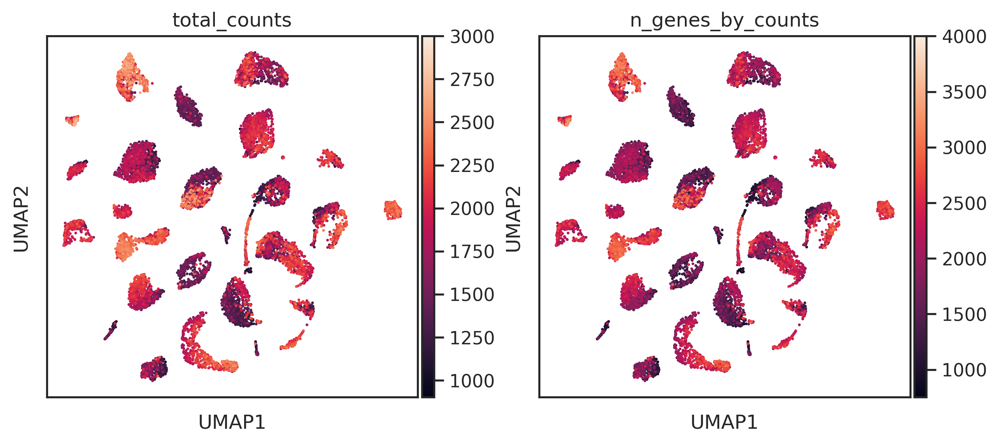

In [33]:
sc.pl.umap(adata, color=["total_counts", "n_genes_by_counts"], vmax=[3000, 4000])

### Определение популяций клеток

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:20)


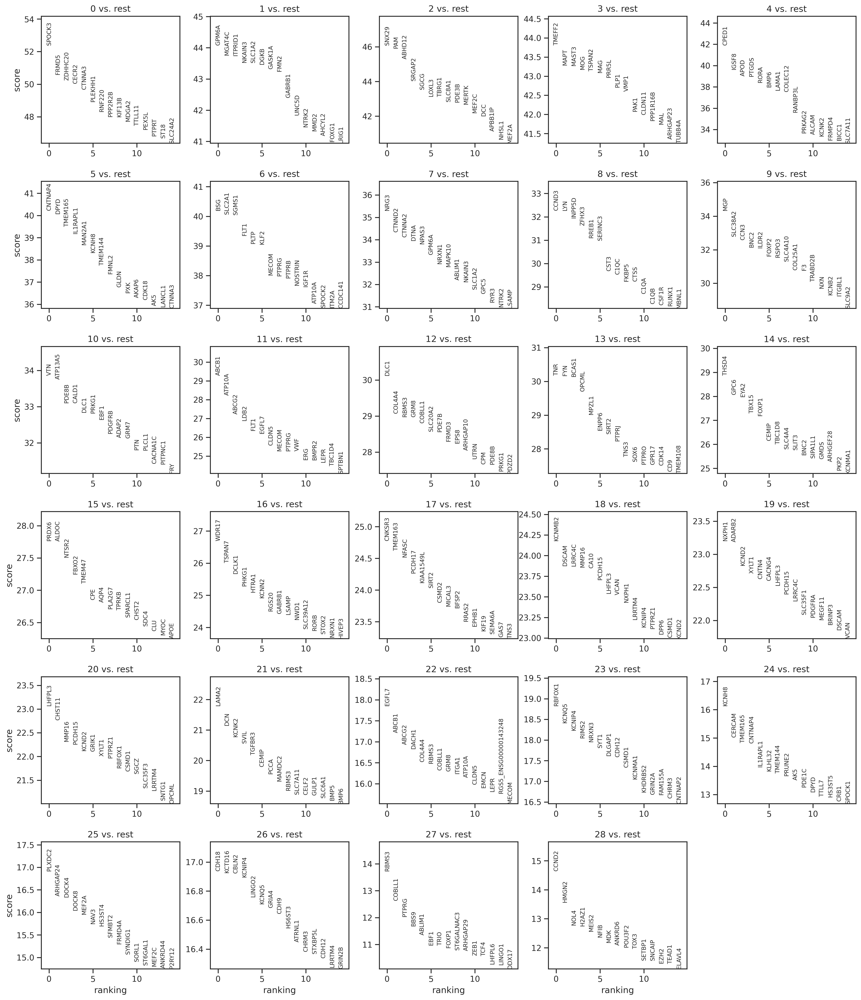

In [34]:
sc.tl.rank_genes_groups(adata, "leiden", method="wilcoxon") # Вычисление маркерных генов
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False, ncols=5) # Список маркерных генов

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


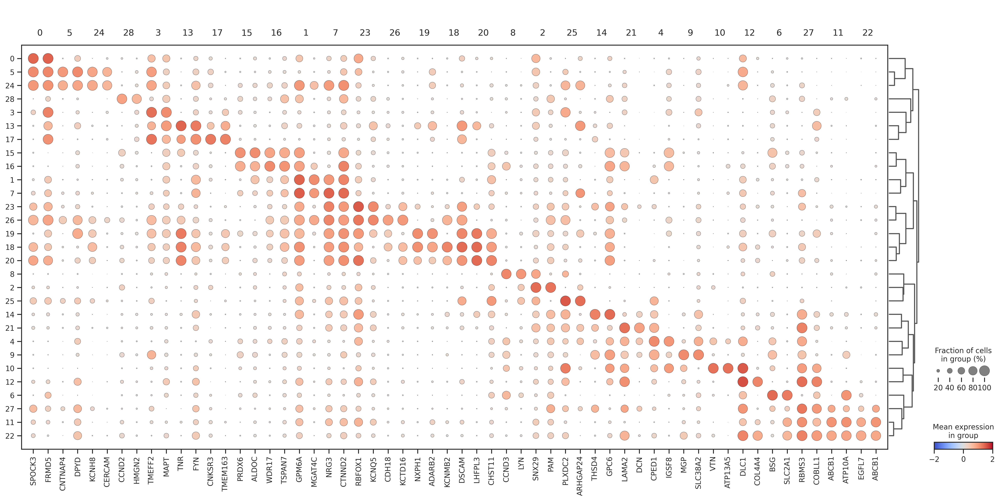

In [35]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    n_genes=2, 
    vmin=-2,
    vmax=2,
    cmap="coolwarm",
)

### Определение по известным маркерным генам

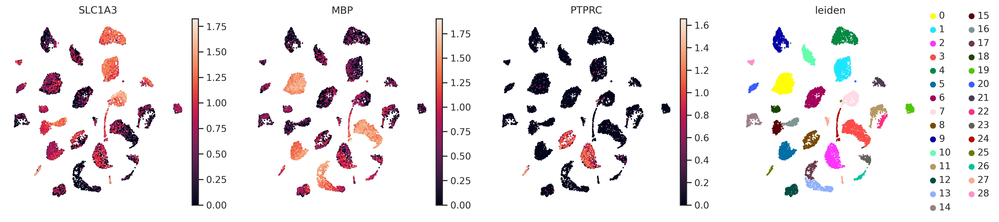

In [36]:
sc.pl.umap(adata, color=["SLC1A3", "MBP", "PTPRC", "leiden"], frameon=False)

Маркерные гены взяты из: 
* https://www.cellsignal.com/science-resources/neural-and-glial-markers
* https://www.cell.com/developmental-cell/fulltext/S1534-5807(11)00269-3
* https://www.abcam.com/neuroscience/oligodendrocyte-markers

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
categories: 0, 1, 2, etc.
var_group_labels: astrocytes, oligodendrocytes, oligodendrocyte precursor cells, etc.


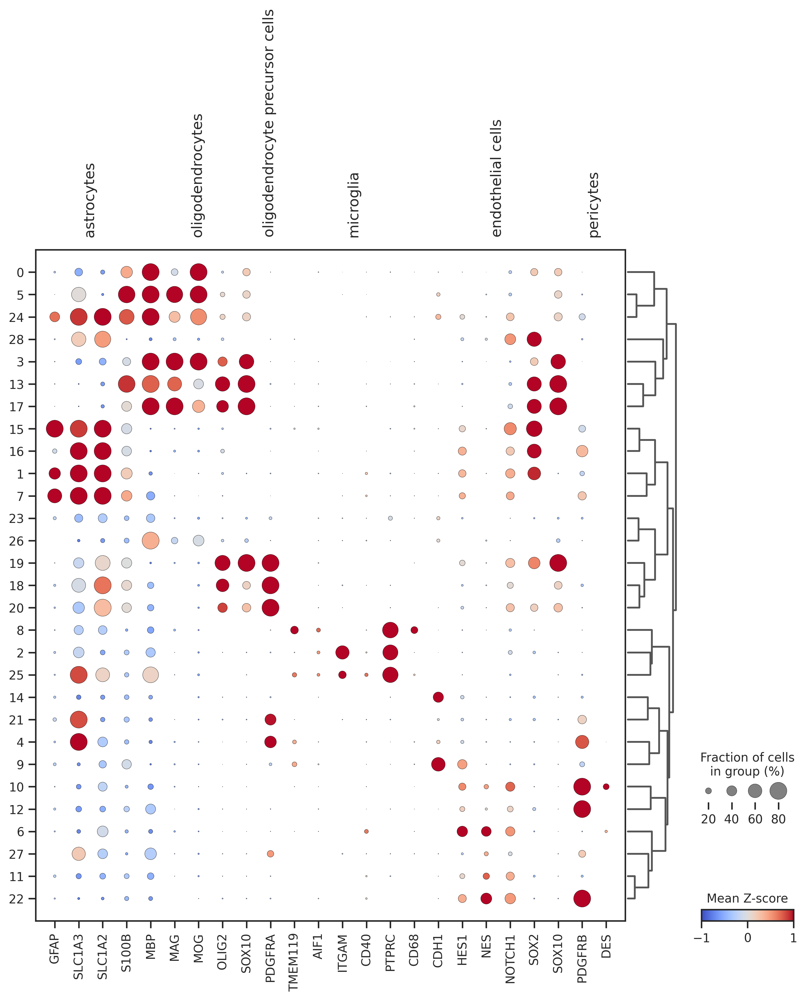

In [37]:
marker_genes_dict = {
    "astrocytes" : ["GFAP", "SLC1A3", "SLC1A2", "S100B"],
    "oligodendrocytes" : ["MBP", "MAG", "MOG", "OLIG2", "SOX10"],
    "oligodendrocyte precursor cells" : ["PDGFRA"],
    "microglia" : ["TMEM119", "AIF1", "ITGAM", "CD40", "PTPRC", "CD68"],
    "endothelial cells" : ["CDH1", "HES1", "NES", "NOTCH1", "SOX2", "SOX10"],
    "pericytes" : ["PDGFRB", "DES"]
} # Словарь с маркерными генами

adata_scaled = adata.raw.to_adata().copy() # Чтобы не отрисовывать экспрессии, можно их отшкалировать в отдельном объекте
adata_scaled.layers["scaled"] = sc.pp.scale(adata_scaled, copy=True).X # Z-скорируем экспрессии
sc.pl.dotplot(adata_scaled, marker_genes_dict, "leiden", layer="scaled", dendrogram=True,
              vmin=-1, vmax=1, cmap="coolwarm", colorbar_title="Mean Z-score", dot_max=0.8)

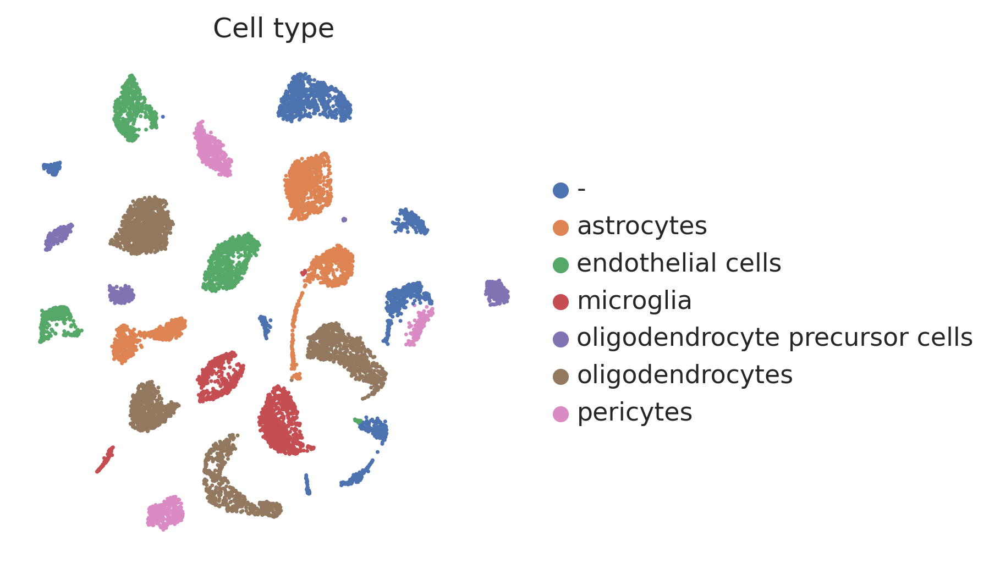

In [38]:
leiden_to_ct = {
    "0" : "oligodendrocytes",
    "1" : "astrocytes",
    "2" : "microglia",
    "3" : "oligodendrocytes",
    "4" : "-",
    "5" : "oligodendrocytes",
    "6" : "endothelial cells",
    "7" : "astrocytes",
    "8" : "microglia",
    "9" : "endothelial cells",
    "10" : "pericytes",
    "11" : "-",
    "12" : "pericytes",
    "13" : "oligodendrocytes",
    "14" : "endothelial cells",
    "15" : "astrocytes",
    "16" : "astrocytes",
    "17" : "oligodendrocytes",
    "18" : "oligodendrocyte precursor cells",
    "19" : "oligodendrocyte precursor cells",
    "20" : "oligodendrocyte precursor cells",
    "21" : "-",
    "22" : "pericytes",
    "23" : "-",
    "24" : "astrocytes",
    "25" : "microglia",
    "26" : "-",
    "27" : "-",
    "28" : "-" 
    # После того, как мы поняли, где какой тип клеток, можно создать вот такой вот словарь
}

adata.obs["cell_type"] = [leiden_to_ct[x] for x in adata.obs.leiden]
sc.pl.umap(adata, color="cell_type", frameon=False, title="Cell type")

Кластеров получилось слишком много, так что клетки одного и того же типа оказались разбиты на несколько кластеров. При этом большинство кластеров, на первый взгляд, действительно содержат в основном клетки одного типа. Возможно, большое количество кластеров связано с тем, что в датасете присутствуют клетки из организмов трех разных видов:

In [39]:
adata.obs['organism_ontology_term_id']

human_AAAGGTATCGGCTGGT-21L8TX_180927_001_A01           NCBITaxon:9606
human_AAGAACACAACACGAG-21L8TX_180927_001_A01           NCBITaxon:9606
human_AAGCGTTCAAGGAGTC-21L8TX_180927_001_A01           NCBITaxon:9606
human_AATGGAAAGTCGAGGT-21L8TX_180927_001_A01           NCBITaxon:9606
human_AATTCCTGTCATCACA-21L8TX_180927_001_A01           NCBITaxon:9606
                                                           ...       
mouse_pBICCNsMMrMOpRPiM008d190320_TTGAACGTCGTTGTGA    NCBITaxon:10090
mouse_pBICCNsMMrMOpRPiM008d190320_TTGGTTTTCGCATTAG    NCBITaxon:10090
mouse_pBICCNsMMrMOpRPiM008d190320_TTTCACATCTGAGCAT    NCBITaxon:10090
mouse_pBICCNsMMrMOpRPiM008d190320_TTTGATCCAGGCTACC    NCBITaxon:10090
mouse_pBICCNsMMrMOpRPiM008d190320_TTTGATCGTTGTGCAT    NCBITaxon:10090
Name: organism_ontology_term_id, Length: 10731, dtype: category
Categories (3, object): ['NCBITaxon:9483', 'NCBITaxon:9606', 'NCBITaxon:10090']

# 1.4
Внимательно прочитайте статью группы Фабиана Тэиса с
бенчмаркингом методов батч-коррекции. Какую метрику они используют для
того, чтобы оценить качество интеграции? Воспользуйтесь той же метрикой
(или теми же метриками, если их несколько) для того, чтобы оценить качество
процессинга ваших данных при помощи метода log1pPF (в вашем случае мы
будем использовать эту метрику для оценки качества процессинга, а не
интеграции!).

Luecken, M.D., Büttner, M., Chaichoompu, K. et al. Benchmarking atlas-level data integration in single-cell genomics. Nat Methods 19, 41–50 (2022). https://doi.org/10.1038/s41592-021-01336-8

In [41]:
!pip install scib
import scib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 74 kB 3.2 MB/s 
     |████████████████████████████████| 1.1 MB 45.7 MB/s 


### principal component regression
Compare the explained variance before and after integration. 
The larger the score (between 0 and 1), the more different the variance contributions are before and after integration

In [42]:
scib.metrics.pcr_comparison(adata_pre=adata_before_log1p, adata_post=adata, covariate="cell_type")

computing PCA
    with n_comps=50
    finished (0:00:20)
computing PCA
    with n_comps=50
    finished (0:00:05)


0.11624465371818163

### graph connectivity
Quantify the connectivity of the subgraph per cell type label. The final score is the average for all cell type labels

In [43]:
scib.metrics.graph_connectivity(adata=adata, label_key="cell_type")

0.5276169956614506

# 1.5
Модифицируйте пайплайн анализа, исключая из него
различные стадии (например, не логарифмируйте экспрессии, не делайте PCA
— попробуйте перебрать различные комбинации, которые только прийдут вам
в голову). В случае какого процессинга ваша метрика (или ваши метрики)
выдают наиболее высокое значение? Какие выводы вы можете сделать из
этого?


### Без нормировки

In [44]:
# Возвращаем adata к исходному виду
adata = adata_before_log1p

# Устранение дуплетов
sce.pp.scrublet(adata)
adata = adata[~adata.obs.predicted_doublet]

# Контроль за дисперсией
adata.layers["counts"] = adata.X.copy() # Сохраняем в слой counts значения сырых каунтов
sc.pp.log1p(adata) # Натуральный логарифм ln(x + 1)

# Подготовка к кластеризации и снижению размерности
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000,
    layer="counts",
    flavor="seurat_v3",
) # Выделяем высоко вариабельные гены (HVG)
adata.raw = adata # Сохраняем изначальные значения экспрессий
adata = adata[:, adata.var.highly_variable] # Оставляем только подмножество генов, которые относятся к HVG
sc.pp.scale(adata) # Шкалирование

# Снижение размерности и кластеризация
sc.tl.pca(adata) # Вычисляем PCA
sc.pp.neighbors(adata, n_pcs=15, n_neighbors=20) # Вычисление графа соседей

Running Scrublet


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
    Scrublet finished (0:00:20)


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


computing UMAP


/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)
running Leiden clustering
    finished: found 33 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


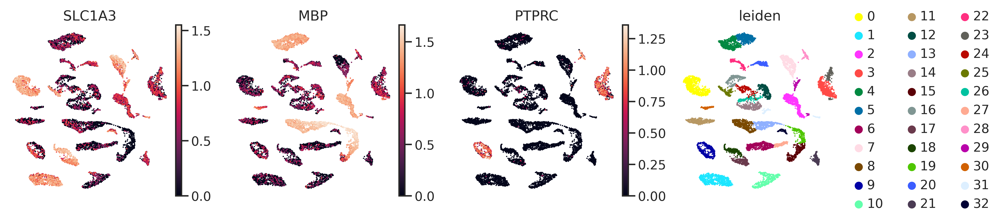

In [45]:
# Отрисовываем получившиеся кластеры (не влияет на значение метрик)
sc.tl.umap(adata, min_dist=0.5) # Рассчёт UMAP
sc.tl.leiden(adata) # Кластеризация алгоритмом Leiden
sc.pl.umap(adata, color=["SLC1A3", "MBP", "PTPRC", "leiden"], frameon=False) # Красим по известным маркерным генам

In [46]:
# principal component regression
scib.metrics.pcr_comparison(adata_pre=adata_before_log1p, adata_post=adata, covariate="cell_type")

computing PCA
    with n_comps=50
    finished (0:00:23)
computing PCA
    with n_comps=50
    finished (0:00:05)


0.0654552469418412

In [47]:
# graph connectivity
scib.metrics.graph_connectivity(adata=adata, label_key="cell_type")

0.5768339357641643

### Без логарифмирования экспрессий

In [48]:
# Возвращаем adata к исходному виду
adata = adata_before_log1p

# Устранение дуплетов
sce.pp.scrublet(adata)
adata = adata[~adata.obs.predicted_doublet]

# Контроль за дисперсией
adata.layers["counts"] = adata.X.copy() # Сохраняем в слой counts значения сырых каунтов
sc.pp.normalize_total(adata) # Нормировка

# Подготовка к кластеризации и снижению размерности
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000,
    layer="counts",
    flavor="seurat_v3",
) # Выделяем высоко вариабельные гены (HVG)
adata.raw = adata # Сохраняем изначальные значения экспрессий
adata = adata[:, adata.var.highly_variable] # Оставляем только подмножество генов, которые относятся к HVG
sc.pp.scale(adata) # Шкалирование

# Снижение размерности и кластеризация
sc.tl.pca(adata) # Вычисляем PCA
sc.pp.neighbors(adata, n_pcs=15, n_neighbors=20) # Вычисление графа соседей

Running Scrublet


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
    Scrublet finished (0:00:22)
normalizing counts per cell
    finished (0:00:00)
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)
running Leiden clustering
    finished: found 32 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


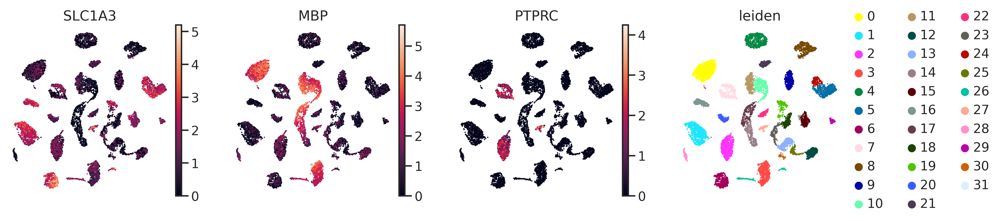

In [49]:
# Отрисовываем получившиеся кластеры (не влияет на значение метрик)
sc.tl.umap(adata, min_dist=0.5) # Рассчёт UMAP
sc.tl.leiden(adata) # Кластеризация алгоритмом Leiden
sc.pl.umap(adata, color=["SLC1A3", "MBP", "PTPRC", "leiden"], frameon=False) # Красим по известным маркерным генам

In [50]:
# principal component regression
scib.metrics.pcr_comparison(adata_pre=adata_before_log1p, adata_post=adata, covariate="cell_type")

computing PCA
    with n_comps=50
    finished (0:00:20)
computing PCA
    with n_comps=50
    finished (0:00:05)


0.05415530953242349

In [51]:
# graph connectivity
scib.metrics.graph_connectivity(adata=adata, label_key="cell_type")

0.5834128831325854

### Без отсечки по высоковариабельным генам

In [52]:
# Возвращаем adata к исходному виду
adata = adata_before_log1p

# Устранение дуплетов
sce.pp.scrublet(adata)
adata = adata[~adata.obs.predicted_doublet]

# Контроль за дисперсией
adata.layers["counts"] = adata.X.copy() # Сохраняем в слой counts значения сырых каунтов
sc.pp.normalize_total(adata) # Нормировка
sc.pp.log1p(adata) # Натуральный логарифм ln(x + 1)

# Подготовка к кластеризации и снижению размерности
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000,
    layer="counts",
    flavor="seurat_v3",
) # Выделяем высоко вариабельные гены (HVG)
adata.raw = adata # Сохраняем изначальные значения экспрессий
sc.pp.scale(adata) # Шкалирование

# Снижение размерности и кластеризация
sc.tl.pca(adata) # Вычисляем PCA
sc.pp.neighbors(adata, n_pcs=15, n_neighbors=20) # Вычисление графа соседей

Running Scrublet


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
    Scrublet finished (0:00:21)
normalizing counts per cell
    finished (0:00:00)


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


computing UMAP


/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)
running Leiden clustering
    finished: found 29 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


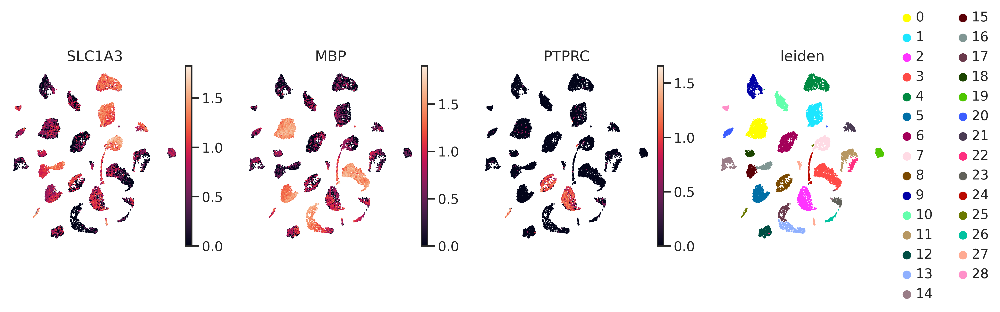

In [53]:
# Отрисовываем получившиеся кластеры (не влияет на значение метрик)
sc.tl.umap(adata, min_dist=0.5) # Рассчёт UMAP
sc.tl.leiden(adata) # Кластеризация алгоритмом Leiden
sc.pl.umap(adata, color=["SLC1A3", "MBP", "PTPRC", "leiden"], frameon=False) # Красим по известным маркерным генам

In [54]:
# principal component regression
scib.metrics.pcr_comparison(adata_pre=adata_before_log1p, adata_post=adata, covariate="cell_type")

computing PCA
    with n_comps=50
    finished (0:00:22)
computing PCA
    with n_comps=50
    finished (0:00:28)


0.18834165998484717

In [55]:
# graph connectivity
scib.metrics.graph_connectivity(adata=adata, label_key="cell_type")

0.5425113806284118

### Без шкалирования

In [56]:
# Возвращаем adata к исходному виду
adata = adata_before_log1p

# Устранение дуплетов
sce.pp.scrublet(adata)
adata = adata[~adata.obs.predicted_doublet]

# Контроль за дисперсией
adata.layers["counts"] = adata.X.copy() # Сохраняем в слой counts значения сырых каунтов
sc.pp.normalize_total(adata) # Нормировка
sc.pp.log1p(adata) # Натуральный логарифм ln(x + 1)

# Подготовка к кластеризации и снижению размерности
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000,
    layer="counts",
    flavor="seurat_v3",
) # Выделяем высоко вариабельные гены (HVG)
adata.raw = adata # Сохраняем изначальные значения экспрессий
adata = adata[:, adata.var.highly_variable] # Оставляем только подмножество генов, которые относятся к HVG

# Снижение размерности и кластеризация
sc.tl.pca(adata) # Вычисляем PCA
sc.pp.neighbors(adata, n_pcs=15, n_neighbors=20) # Вычисление графа соседей

Running Scrublet


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
    Scrublet finished (0:00:19)
normalizing counts per cell
    finished (0:00:00)


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:04)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)
running Leiden clustering
    finished: found 33 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


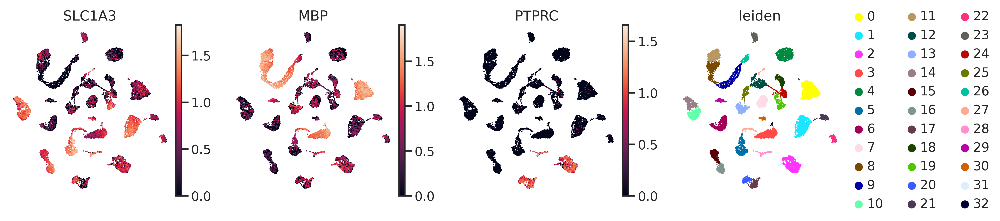

In [57]:
# Отрисовываем получившиеся кластеры (не влияет на значение метрик)
sc.tl.umap(adata, min_dist=0.5) # Рассчёт UMAP
sc.tl.leiden(adata) # Кластеризация алгоритмом Leiden
sc.pl.umap(adata, color=["SLC1A3", "MBP", "PTPRC", "leiden"], frameon=False) # Красим по известным маркерным генам

In [58]:
# principal component regression
scib.metrics.pcr_comparison(adata_pre=adata_before_log1p, adata_post=adata, covariate="cell_type")

computing PCA
    with n_comps=50
    finished (0:00:22)
computing PCA
    with n_comps=50
    finished (0:00:04)
Variance contribution increased after integration!
Setting PCR comparison score to 0.


0

In [59]:
# graph connectivity
scib.metrics.graph_connectivity(adata=adata, label_key="cell_type")

0.7118115798182713

### Без PCA

In [60]:
# Возвращаем adata к исходному виду
adata = adata_before_log1p

# Устранение дуплетов
sce.pp.scrublet(adata)
adata = adata[~adata.obs.predicted_doublet]

# Контроль за дисперсией
adata.layers["counts"] = adata.X.copy() # Сохраняем в слой counts значения сырых каунтов
sc.pp.normalize_total(adata) # Нормировка
sc.pp.log1p(adata) # Натуральный логарифм ln(x + 1)

# Подготовка к кластеризации и снижению размерности
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000,
    layer="counts",
    flavor="seurat_v3",
) # Выделяем высоко вариабельные гены (HVG)
adata.raw = adata # Сохраняем изначальные значения экспрессий
adata = adata[:, adata.var.highly_variable] # Оставляем только подмножество генов, которые относятся к HVG
sc.pp.scale(adata) # Шкалирование

# Кластеризация
sc.pp.neighbors(adata, n_pcs=15, n_neighbors=20) # Вычисление графа соседей

Running Scrublet


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
    Scrublet finished (0:00:20)
normalizing counts per cell
    finished (0:00:00)


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)
running Leiden clustering
    finished: found 20 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


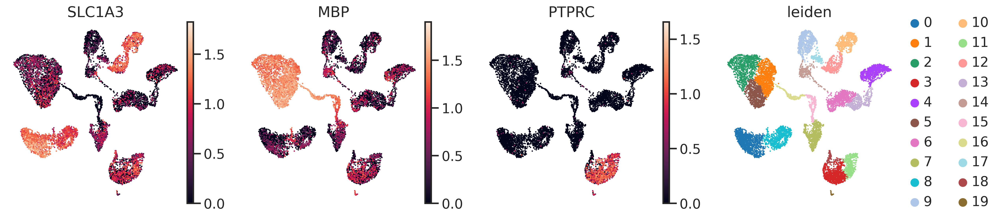

In [61]:
# Отрисовываем получившиеся кластеры (не влияет на значение метрик)
sc.tl.umap(adata, min_dist=0.5) # Рассчёт UMAP
sc.tl.leiden(adata) # Кластеризация алгоритмом Leiden
sc.pl.umap(adata, color=["SLC1A3", "MBP", "PTPRC", "leiden"], frameon=False) # Красим по известным маркерным генам

In [62]:
# principal component regression
scib.metrics.pcr_comparison(adata_pre=adata_before_log1p, adata_post=adata, covariate="cell_type")

computing PCA
    with n_comps=50
    finished (0:00:20)
computing PCA
    with n_comps=50
    finished (0:00:05)


0.030198306141251737

In [63]:
# graph connectivity
scib.metrics.graph_connectivity(adata=adata, label_key="cell_type")

0.9916216387734521

На мой взгляд, наилучшие результаты дал вариант без PCA, поэтому с ним интересно построить еще графики:

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
    using 'X_pca' with n_pcs = 100
Storing dendrogram info using `.uns['dendrogram_leiden']`
categories: 0, 1, 2, etc.
var_group_labels: astrocytes, oligodendrocytes, oligodendrocyte precursor cells, etc.


/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


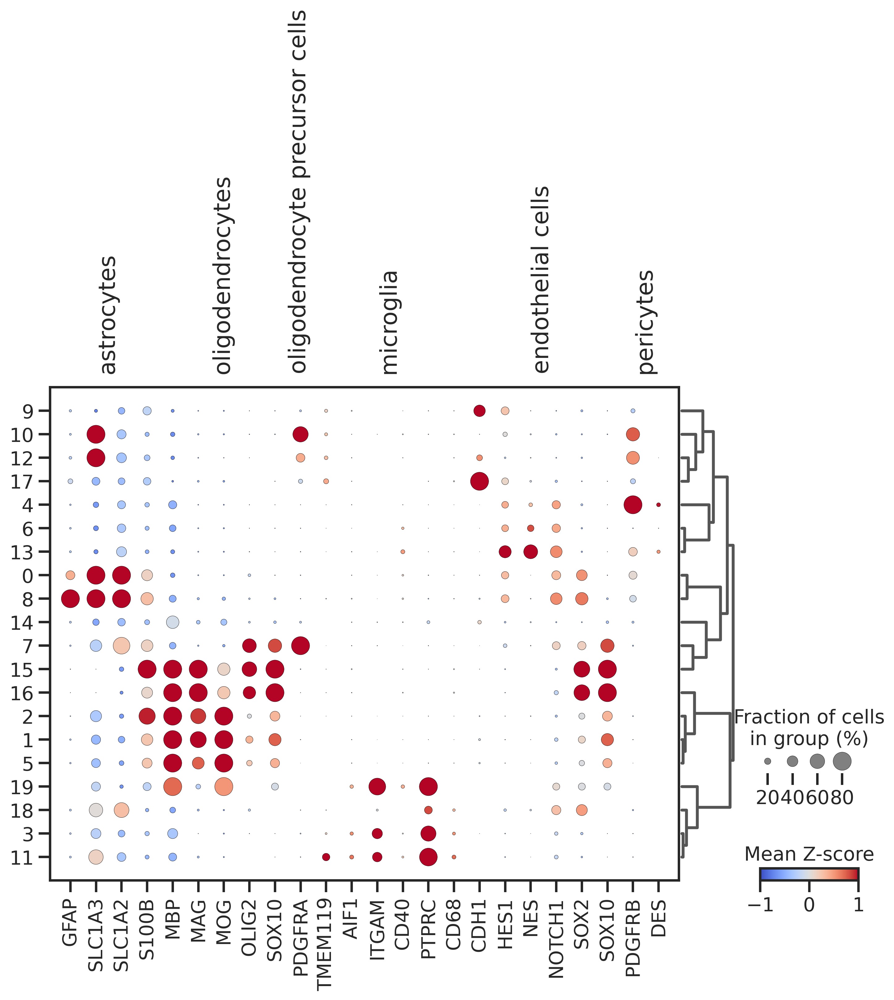

In [64]:
marker_genes_dict = {
    "astrocytes" : ["GFAP", "SLC1A3", "SLC1A2", "S100B"],
    "oligodendrocytes" : ["MBP", "MAG", "MOG", "OLIG2", "SOX10"],
    "oligodendrocyte precursor cells" : ["PDGFRA"],
    "microglia" : ["TMEM119", "AIF1", "ITGAM", "CD40", "PTPRC", "CD68"],
    "endothelial cells" : ["CDH1", "HES1", "NES", "NOTCH1", "SOX2", "SOX10"],
    "pericytes" : ["PDGFRB", "DES"]
} # Словарь с маркерными генами

adata_scaled = adata.raw.to_adata().copy() # Чтобы не отрисовывать экспрессии, можно их отшкалировать в отдельном объекте
adata_scaled.layers["scaled"] = sc.pp.scale(adata_scaled, copy=True).X # Z-скорируем экспрессии
sc.pl.dotplot(adata_scaled, marker_genes_dict, "leiden", layer="scaled", dendrogram=True,
              vmin=-1, vmax=1, cmap="coolwarm", colorbar_title="Mean Z-score", dot_max=0.8)

/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


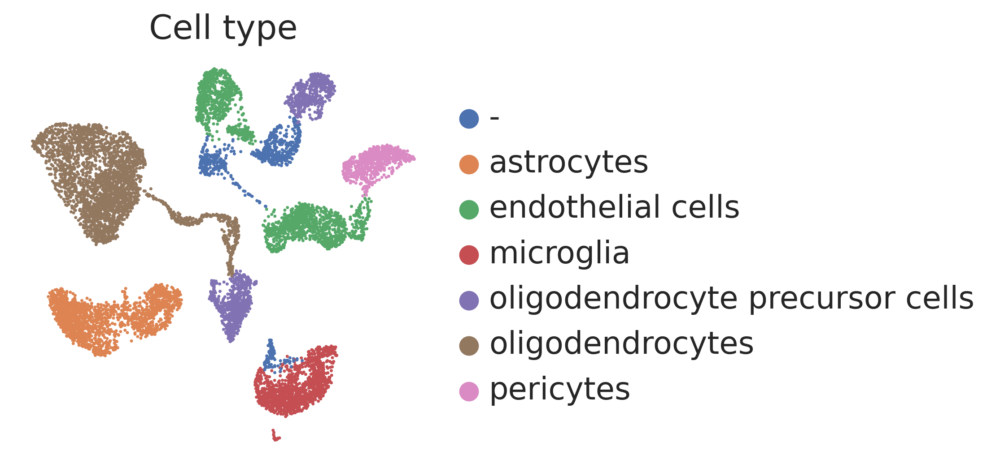

In [65]:
leiden_to_ct = {
    "0" : "astrocytes",
    "1" : "oligodendrocytes",
    "2" : "oligodendrocytes",
    "3" : "microglia",
    "4" : "pericytes",
    "5" : "oligodendrocytes",
    "6" : "endothelial cells",
    "7" : "oligodendrocyte precursor cells",
    "8" : "astrocytes",
    "9" : "endothelial cells",
    "10" : "oligodendrocyte precursor cells",
    "11" : "microglia",
    "12" : "-",
    "13" : "endothelial cells",
    "14" : "-",
    "15" : "oligodendrocytes",
    "16" : "oligodendrocytes",
    "17" : "endothelial cells",
    "18" : "-",
    "19" : "microglia",
}

adata.obs["cell_type"] = [leiden_to_ct[x] for x in adata.obs.leiden]
sc.pl.umap(adata, color="cell_type", frameon=False, title="Cell type")

Разделение на кластеры стало ближе к разделению клеток по типам

Так как PCA сокращает размерность, то ожидаемо, значение principal component regression ниже без применения PCA (остается больше данных - больше доля вариации данных, учитываемая моделью). Кластеризация тоже прошла успешнее без PCA - получается, он удалил не только шум, но и полезную информацию

# 1.6 
Напишите функцию, которая будет подбирать лучшие
параметры числа главных компонент, числа соседей в kNN-графе и т. п. для
данного датасета с известной аннотацией. Каковы эти значения в вашем
случае?


### Подбираем лучшее количество главных компонент

In [66]:
# Возвращаем adata к исходному виду
adata = adata_before_log1p

# Устранение дуплетов
sce.pp.scrublet(adata)
adata = adata[~adata.obs.predicted_doublet]

# Контроль за дисперсией
adata.layers["counts"] = adata.X.copy() # Сохраняем в слой counts значения сырых каунтов
sc.pp.normalize_total(adata) # Нормировка
sc.pp.log1p(adata) # Натуральный логарифм ln(x + 1)

# Подготовка к кластеризации и снижению размерности
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000,
    layer="counts",
    flavor="seurat_v3",
) # Выделяем высоко вариабельные гены (HVG)
adata.raw = adata # Сохраняем изначальные значения экспрессий
adata = adata[:, adata.var.highly_variable] # Оставляем только подмножество генов, которые относятся к HVG
sc.pp.scale(adata) # Шкалирование

adata_before_pca = adata # Сохраняем adata до PCA

Running Scrublet


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
    Scrublet finished (0:00:20)
normalizing counts per cell
    finished (0:00:00)


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [68]:
graph_conns = []

for i in range(1, 50):
  adata = adata_before_pca

  # Снижение размерности и кластеризация
  print(i)
  sc.tl.pca(data=adata, n_comps=i) # Вычисляем PCA (Defaults to 50, or 1 - minimum dimension size of selected representation)
  sc.pp.neighbors(adata, n_neighbors=20) # Вычисление графа соседей

  # graph connectivity - для нахождения лучшего значения параметра используем метрику из предыдущих пунктов
  graph_conn = scib.metrics.graph_connectivity(adata=adata, label_key="cell_type")
  graph_conns.append(graph_conn)

1
computing PCA
    on highly variable genes
    with n_comps=1
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 1
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
2
computing PCA
    on highly variable genes
    with n_comps=2
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 2
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
3
computing PCA
    on highly variable genes
    with n_comps=3
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 3
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
4
computing PCA
    on highly variable genes
    with n_comps

In [76]:
rows = len(graph_conns)+1

df = pd.DataFrame({'n_comps':[i for i in range(1, rows)], 'graph_connectivity':graph_conns})
df.set_index('n_comps', inplace=True)

df.sort_values('graph_connectivity', ascending=False).head()

,graph_connectivity
n_comps,
4,0.958201
3,0.901045
2,0.868791
7,0.823687
5,0.816698


<AxesSubplot: xlabel='n_comps'>

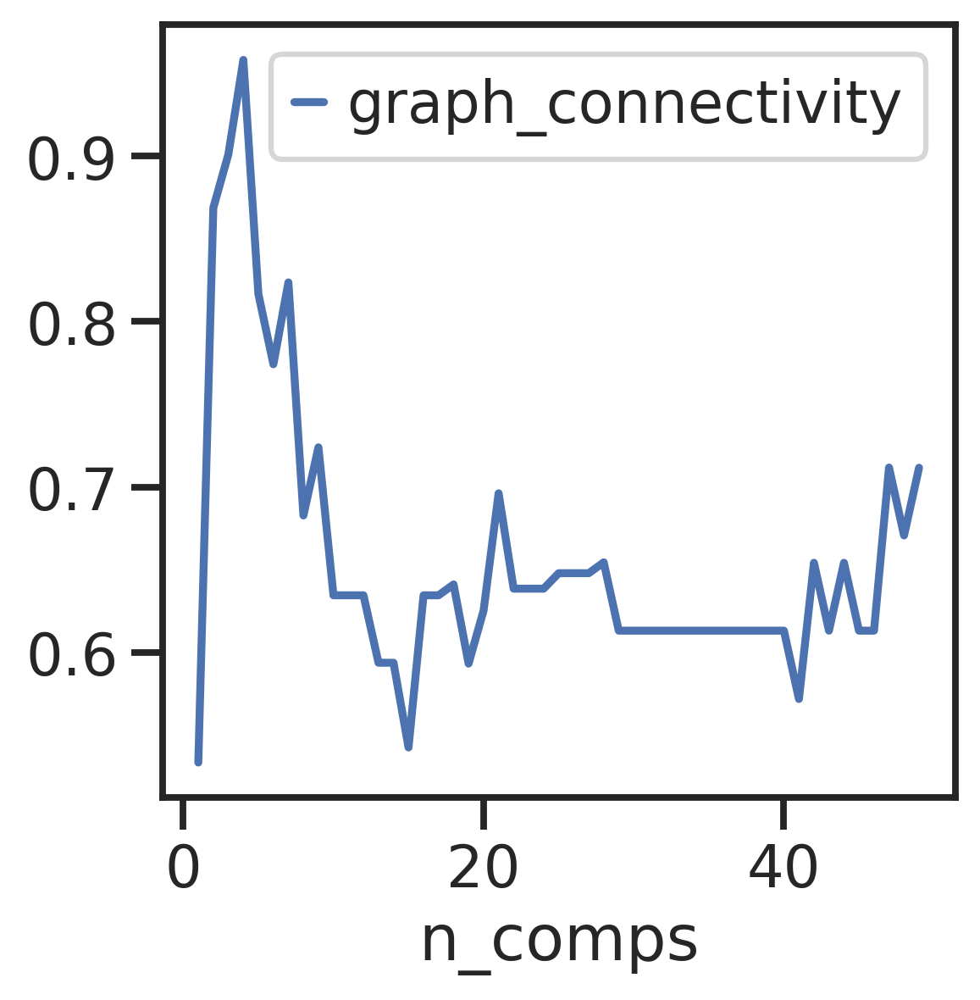

In [77]:
sns.lineplot(data=df)

Согласно метрике graph_connectivity, наилучшее количество главных компонент - 4

### Подбираем лучшее количество соседей в графе

In [90]:
graph_conns = []

adata = adata_before_pca
sc.tl.pca(data=adata, n_comps=4) # Вычисляем PCA с найденным наилучшим количеством главных компонент
adata_before_graph = adata

for i in range(1, 41):
  adata = adata_before_graph

  print(i)
  sc.pp.neighbors(adata, n_neighbors=i) # Вычисление графа соседей (до этого в анализе использовалось n_neighbors=20)

  # graph connectivity
  graph_conn = scib.metrics.graph_connectivity(adata=adata, label_key="cell_type")
  graph_conns.append(graph_conn)

computing PCA
    on highly variable genes
    with n_comps=4
    finished (0:00:01)
1
computing neighbors
    using 'X_pca' with n_pcs = 4
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
2
computing neighbors
    using 'X_pca' with n_pcs = 4
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
3
computing neighbors
    using 'X_pca' with n_pcs = 4
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
4
computing neighbors
    using 'X_pca' with n_pcs = 4
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
5
c

In [99]:
rows = len(graph_conns)+1

df = pd.DataFrame({'n_neighbors':[i for i in range(1, rows)], 'graph_connectivity':graph_conns})
df.set_index('n_neighbors', inplace=True)

df.sort_values('graph_connectivity', ascending=False).head()

,graph_connectivity
n_neighbors,
40,0.978289
35,0.978080
30,0.978080
31,0.978080
33,0.978080


<AxesSubplot: xlabel='n_neighbors'>

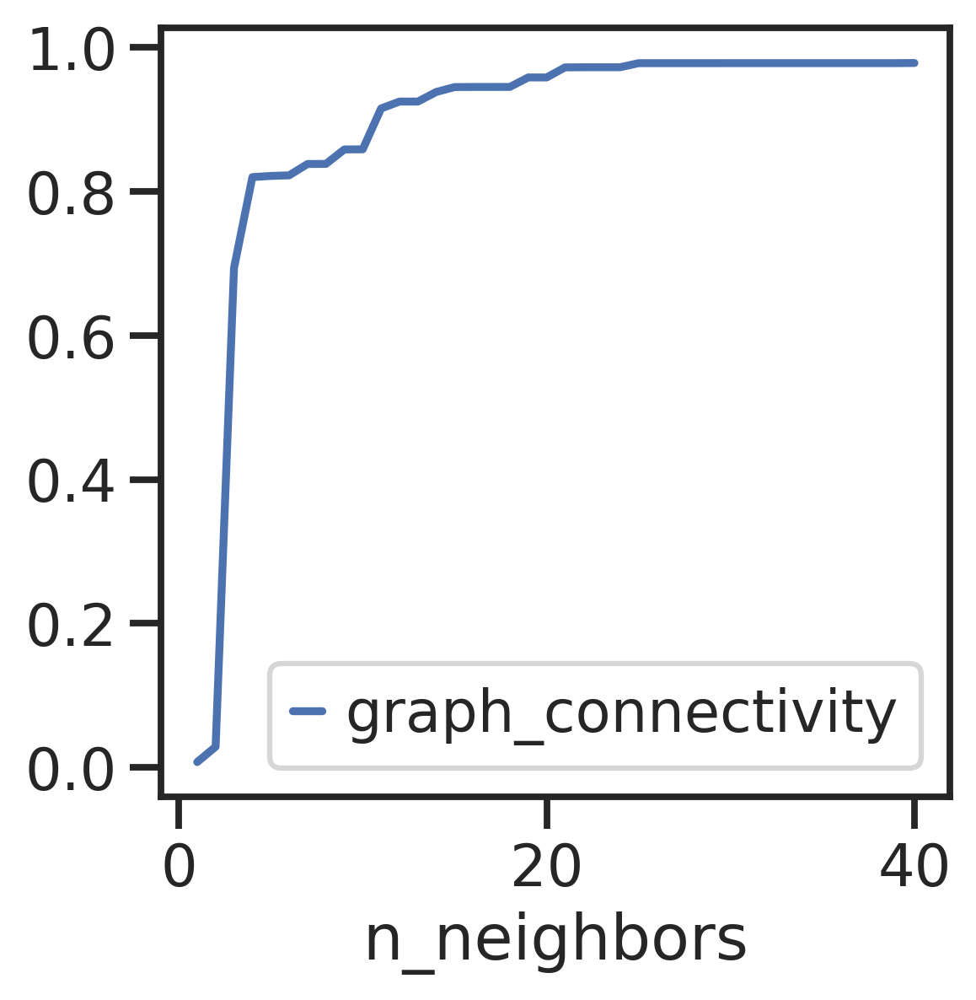

In [100]:
sns.lineplot(data=df)

Graph_connectivity не перестает расти (она тем выше, чем больше соседей в графе), поэтому найдем не абсолютный максимум, а где она начинает расти медленнее:

In [108]:
previous = [0]
for i in range(len(list(df['graph_connectivity']))-1):
  previous.append(list(df['graph_connectivity'])[i])

df['gc_delta'] = df['graph_connectivity'] - previous

df.sort_values('gc_delta', ascending=False).head()

,graph_connectivity,gc_delta
n_neighbors,,
3,0.693488,0.664912
4,0.819789,0.126301
11,0.915143,0.056733
2,0.028576,0.021240
9,0.858222,0.020094


Можно остановиться на n_neighbors	= 11. Посмотрим, какие кластеры получатся при использовании подобранных параметров:

computing neighbors
    using 'X_pca' with n_pcs = 4
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:13)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


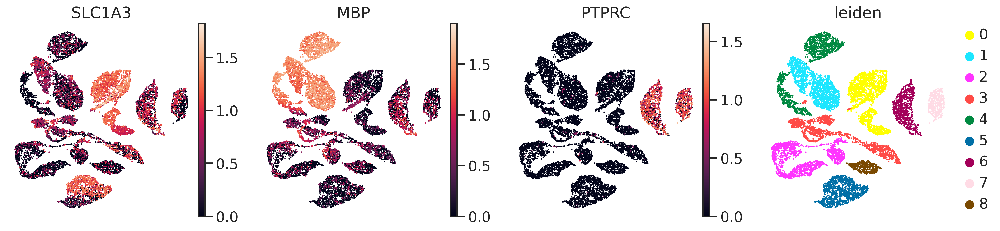

In [139]:
adata = adata_before_graph

sc.pp.neighbors(adata, n_neighbors=11) # Вычисление графа соседей 

# Отрисовываем получившиеся кластеры (не влияет на значение метрик)
sc.tl.umap(adata, min_dist=0.5) # Рассчёт UMAP
sc.tl.leiden(adata, resolution=0.02) # Кластеризация алгоритмом Leiden, попробуем заодно ограничить количество кластеров
# resolution - default: 1, higher values lead to more clusters
sc.pl.umap(adata, color=["SLC1A3", "MBP", "PTPRC", "leiden"], frameon=False) # Красим по известным маркерным генам

# 1.7
Попробуйте воспользоваться нестандартными подходами,
которые мы обсуждали во время занятия — например, кластеризацией при
помощи K-Means на пространстве PCA, используйте SVD вместо PCA, берите
корень вместо логарифмирования — работает ли какой-то из методов для
вашего датасета лучше, чем log1pPF?

### Корень вместо логарифмирования

In [110]:
# Возвращаем adata к исходному виду
adata = adata_before_log1p

# Устранение дуплетов
sce.pp.scrublet(adata)
adata = adata[~adata.obs.predicted_doublet]

# Контроль за дисперсией
adata.layers["counts"] = adata.X.copy() # Сохраняем в слой counts значения сырых каунтов
sc.pp.normalize_total(adata) # Нормировка
adata.X = np.sqrt(adata.X) # Корень вместо логарифмирования

# Подготовка к кластеризации и снижению размерности
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000,
    layer="counts",
    flavor="seurat_v3",
) # Выделяем высоко вариабельные гены (HVG)
adata.raw = adata # Сохраняем изначальные значения экспрессий
adata = adata[:, adata.var.highly_variable] # Оставляем только подмножество генов, которые относятся к HVG
sc.pp.scale(adata) # Шкалирование

# Снижение размерности и кластеризация
sc.tl.pca(adata) # Вычисляем PCA
sc.pp.neighbors(adata, n_pcs=15, n_neighbors=20) # Вычисление графа соседей

Running Scrublet


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
    Scrublet finished (0:00:24)
normalizing counts per cell
    finished (0:00:00)


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


computing UMAP


/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)
running Leiden clustering
    finished: found 30 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


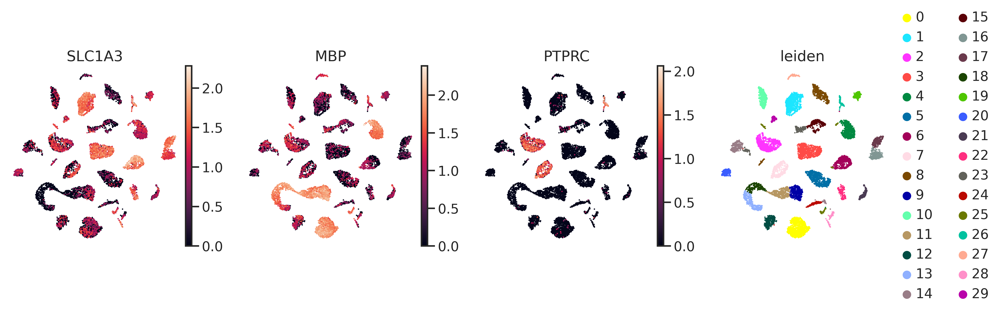

In [111]:
# Отрисовываем получившиеся кластеры
sc.tl.umap(adata, min_dist=0.5) # Рассчёт UMAP
sc.tl.leiden(adata) # Кластеризация алгоритмом Leiden
sc.pl.umap(adata, color=["SLC1A3", "MBP", "PTPRC", "leiden"], frameon=False) # Красим по известным маркерным генам

### С применением K-Means

In [112]:
import sklearn
from sklearn.cluster import KMeans

In [113]:
# Возвращаем adata к исходному виду
adata = adata_before_log1p

# Устранение дуплетов
sce.pp.scrublet(adata)
adata = adata[~adata.obs.predicted_doublet]

# Контроль за дисперсией
adata.layers["counts"] = adata.X.copy() # Сохраняем в слой counts значения сырых каунтов
sc.pp.normalize_total(adata) # Нормировка
sc.pp.log1p(adata) # Натуральный логарифм ln(x + 1)

# Подготовка к кластеризации и снижению размерности
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000,
    layer="counts",
    flavor="seurat_v3",
) # Выделяем высоко вариабельные гены (HVG)
adata.raw = adata # Сохраняем изначальные значения экспрессий
adata = adata[:, adata.var.highly_variable] # Оставляем только подмножество генов, которые относятся к HVG
sc.pp.scale(adata) # Шкалирование

# Снижение размерности и кластеризация
sc.tl.pca(adata) # Вычисляем PCA

X_pca = adata.obsm['X_pca'] 
# kmeans with k=5
kmeans = KMeans(n_clusters=5, random_state=0).fit(X_pca) 
adata.obs['kmeans5'] = kmeans.labels_.astype(str)
# kmeans with k=10
kmeans = KMeans(n_clusters=10, random_state=0).fit(X_pca) 
adata.obs['kmeans10'] = kmeans.labels_.astype(str)
# kmeans with k=15
kmeans = KMeans(n_clusters=15, random_state=0).fit(X_pca) 
adata.obs['kmeans15'] = kmeans.labels_.astype(str)

Running Scrublet


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
    Scrublet finished (0:00:19)
normalizing counts per cell
    finished (0:00:00)


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)


/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


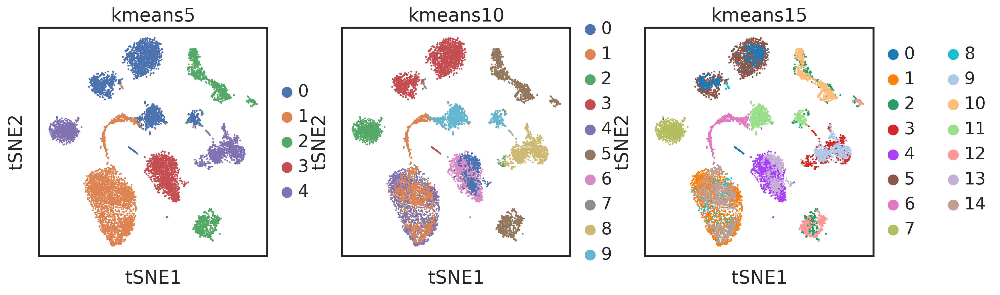

In [114]:
# Отрисовываем получившиеся кластеры
sc.pl.tsne(adata, color=['kmeans5', 'kmeans10', 'kmeans15'])

### SVD вместо PCA

In [116]:
# Возвращаем adata к исходному виду
adata = adata_before_log1p

# Устранение дуплетов
sce.pp.scrublet(adata)
adata = adata[~adata.obs.predicted_doublet]

# Контроль за дисперсией
adata.layers["counts"] = adata.X.copy() # Сохраняем в слой counts значения сырых каунтов
sc.pp.normalize_total(adata) # Нормировка
sc.pp.log1p(adata) # Натуральный логарифм ln(x + 1)

# Подготовка к кластеризации и снижению размерности
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000,
    layer="counts",
    flavor="seurat_v3",
) # Выделяем высоко вариабельные гены (HVG)
adata.raw = adata # Сохраняем изначальные значения экспрессий
adata = adata[:, adata.var.highly_variable] # Оставляем только подмножество генов, которые относятся к HVG
sc.pp.scale(adata) # Шкалирование

Running Scrublet


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.1%
    Scrublet finished (0:00:19)
normalizing counts per cell
    finished (0:00:00)


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [124]:
# Снижение размерности и кластеризация
from sklearn.decomposition import TruncatedSVD
svd = TruncatedSVD()
adata.obsm['svd'] = svd.fit_transform(adata.X) # Вычисляем SVD

sc.pp.neighbors(adata, n_pcs=15, n_neighbors=20) # Вычисление графа соседей

computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
